# CS448 - Lab 4: 3D Audio


In this lab we will learn how to create 3D sounds for headphone playback. We will make use of simple filters and HRTFs to create static and moving sources. Use the three sounds fly.wav, helicopter.wav, and crumble.wav in the lab archive as sources for the 3D recording that you will create.

## Part 1: Static sources using ITD/ILD cues

Assume the following source locations: 

- Straight ahead

- 45 degrees to the left

- 80 degrees to the right

- 160 degrees to the left

For each location find the source’s delay between the two ears (assume a source distance of 2 meters), and design two filters that will simulate that ITD and ILD features (feel free to round the IDT delays to an integer sample size). Assume that when sounds come from the side of the head the attenuation at the contralateral ear is by a factor of 0.7. From sounds coming medial plane (between the ears) there will be no attenuation due to the head. For positions moving from the medial plane towards the sides you can interpolate between no attenuation and a factor of 0.7. Design and plot the filters that correspond to the locations shown above and use them to make 3D sounds with the following sounds:

- Crumbling paper: [https://drive.google.com/uc?export=download&id=1bsZArYwMftsuCLdMknRomz4kAJWT-Uhv ]

- Fly: [https://drive.google.com/uc?export=download&id=1bswUsI28yJOUQuNLvNxq3pu9qj0bb8ne ]

- Helicopter: [https://drive.google.com/uc?export=download&id=1c8YhNNLmaO7CA2dJNCkBsB9MY0HjHDRL ]

Listen to the result through headphones and verify that they sound somewhat localized (it won’t sound perfect, but it should be believable).  There is no need to render all three sounds, since the notebook will become very large and hard to upload.  At submission time just render one sound, but make sure that you listen to all three and that they sound good.

In [85]:
from scipy.io import wavfile
import matplotlib.pyplot as plt
import numpy as np
from scipy import signal
import soundfile as sf

# Make a sound player function that plays array "x" with a sample rate "rate", and labels it with "label"
def play_sound( x, rate=8000, label=''):
    from IPython.display import display, Audio, HTML
    display( HTML( 
    '<style> table, th, td {border: 0px; }</style> <table><tr><td>' + label + 
    '</td><td>' + Audio( x, rate=rate)._repr_html_()[3:] + '</td></tr></table>'
    ))

def plot_sound(sound,duration=1,sample_rate=8000):
    t = np.linspace(0,duration,int(sample_rate*duration))
    plt.plot(t,sound)
    plt.xlabel('Time')
    plt.ylabel('Amplitude')

In [87]:
# read sound file
sample_rate,sound = wavfile.read("crumble.wav")
ears_distance = 0.22  # meter
sound_speed = 340
gain = 0.7

def get_left_and_right_distance(d,angle):
    angle = np.deg2rad(angle)
    ab = d*np.cos(angle)
    bd = d*np.sin(angle)
    bc = bd - ears_distance/2
    left_ear_distance = np.sqrt(ab**2+bc**2)
    be = bd + ears_distance/2
    right_ear_distance = np.sqrt(ab**2+be**2)
    return left_ear_distance, right_ear_distance

def get_filter(distance):
    time_seconds = distance/sound_speed
    num_samples = int(time_seconds*sample_rate)+1
    filter = np.zeros(num_samples)
    filter[-1] = gain
    return filter

titles = ["straight", "45 degrees, left", "80 degrees, right", "160 degrees, left"]
angles = [0,45,-80,160]
d = 2
for i in range(len(titles)):
    angle = angles[i]
    title = titles[i]
    left_ear_distance, right_ear_distance = get_left_and_right_distance(d,angle)
    left_ear_filter = get_filter(left_ear_distance)
    right_ear_filter = get_filter(right_ear_distance)
    left_sound = signal.lfilter(left_ear_filter, [1], sound)
    right_sound = signal.lfilter(right_ear_filter, [1], sound)
    object = "crumble"
    play_sound([left_sound, right_sound],sample_rate,"{}, {} 3D audio, using ITD/ILD".format(title, object))


"straight, crumble 3D audio, using ITD/ILD"


"45 degrees, left, crumble 3D audio, using ITD/ILD"


"80 degrees, right, crumble 3D audio, using ITD/ILD"


"160 degrees, left, crumble 3D audio, using ITD/ILD"


## Part 2. Static sources using HRTFs

Download the HTTF archive from [https://drive.google.com/uc?export=download&id=1vFzSo-zlNFI-q2T9yvRRmOeZ-elZ8lW3 ]. In that directory you will also find code for the function load_hrtf which returns the left and right HRTF filters given as input a source’s azimuth and elevation. These filters will be much better than the ITD/ILD filters for localizing sounds.

Apply the HRTFs on the given sources and create 3D sounds that correspond to the locations given above. For each source, you will beed to convolve it with the left and right HRTF of the desired position and generate two sounds, one for each channel. Verify that they sound correct using headphones; are they better than before? What differences do you observe? When you use these make sure that the sample rates of the HRTFs and the sounds you convolve them with match.  The HRTFs are sampled at 44.1kHz.

Once again, just render one example before submission (the same as before so that we can compare).

In [88]:
print("I tried to impor the python file from the folder, but I failed.")
print("So, I directly put the function here.")
def load_hrtf( ad, ed):
    # Return the HRTFs for a given azimuth and elevation
    #  function h,a,e = load_hrtf( ad, ed)
    #
    # Inputs:
    #   ad  is the azimuth to use in degrees (0 is front)
    #   ed  is the elevation to use in degrees (0 is level with ears)
    #
    # Output:
    #   l,r two 128pt arrays, first is left ear HRTF, second is right ear HRTF
    import numpy as np

    # Path where the HRTFs are
    p = 'hrtf/compact/'

    # Get nearest available elevation
    e = max( -40, min( 90, 10*(ed//10)))

    # Get nearest available azimuth
    ad = np.remainder( ad, 360)
    if ad > 180:
        ad = ad-360
    if ad < 0:
        a = abs( ad)
        fl = 1
    else:
        a = ad
        fl = 0
    a = max( 0, min( 180, 5*(a//5)))

    # Load appropriate response
    h = np.fromfile( '%s/elev%d/H%de%.3da.dat' % (p, e, e, a), dtype='>i2').astype( 'double')/32768
    if fl:
        return h[1::2],h[::2]
    else:
        return h[::2],h[1::2]

def convolve_stereo(x, stereo):
    x_l = np.convolve(x, stereo[0])
    x_r = np.convolve(x, stereo[1])
    return [x_l, x_r]

def hrtf(sound, a_angle, e_angle):
    l, r = load_hrtf(a_angle, e_angle)
    sound_left = np.convolve(sound,l)
    sound_right = np.convolve(sound,r)
    return [sound_left, sound_right]

I tried to impor the python file from the folder, but I failed.
So, I directly put the function here.


In [89]:
titles = ["straight", "45 degrees, left", "80 degrees, right", "160 degrees, left"]
angles = [0,-45,80,-160]
#import the given HRTFs
for i in range(len(angles)):
    angle = angles[i]
    title = titles[i]
    left_filter, right_filter = load_hrtf(angle,0)
    left_sound = np.convolve(sound,left_filter)
    right_sound = np.convolve(sound,right_filter)
    object = "crumble"
    play_sound([left_sound,right_sound],sample_rate,"{}, {} 3D audio, using HRTFs".format(title, object))



"straight, crumble 3D audio, using HRTFs"


"45 degrees, left, crumble 3D audio, using HRTFs"


"80 degrees, right, crumble 3D audio, using HRTFs"


"160 degrees, left, crumble 3D audio, using HRTFs"


## Part 3. Dynamic Sources with HRTFs

In this part you will need to make a moving sound source. In order to do so we will make use of a fast convolution routine based on your STFT code from lab 1 (ha, you thought you were done with that!). In order to perform fast convolution we can perform an STFT of the sound to use, multiply each time frame of this transform with the DFT of the filter that we want  to impose and then use overlap add to transform back to the time domain.

Start by taking each sound from above, and apply your STFT on it. Make sure that the size of the transform is the same as the HRTF’s filter length. The hop size should be the same as the DFT size and you will need to zero pad by as much as the DFT size in order to facilitate the tail of the convolution. Do not use an analysis/synthesis window.

Once you compute this STFT, go through its every time frame and element-wise multiply it with the desired HRTF filter to generate the STFT of the left and right sounds. Figure out which HRTF angle to multiply each frame with so that by the end of the sound you will have made it go around your head.

Once you perform these operations you will have generated two STFT matrices, one for the left channel and one for the right. Use your inverse STFT routine and play the stereo sound through your headphones. You should hear a convincing rendering of the original sounds circling around your head.

Submit only one of the sounds, but make sure you try it on all and that it sounds ok.

In [90]:
def stft( input_sound, dft_size, hop_size, window, zero_padding):
    #add some zeros at the end
    num_of_hop = (len(input_sound)-dft_size)//hop_size +1
    num_zeros = num_of_hop*hop_size + dft_size - len(input_sound)
    zeros_array = np.zeros(num_zeros)
    sound = np.concatenate((input_sound,zeros_array))
    #segment the input into frames
    frames = []
    for i in range(0,(len(sound)-dft_size+1),hop_size):
        frame = sound[i:(i+dft_size)]
        spectrum_of_frame = np.fft.rfft(frame*window,dft_size+zero_padding)
        frames.append(spectrum_of_frame)

    # Return a complex-valued spectrogram (frequencies x time)
    return frames



def istft( stft_output, dft_size, hop_size, window, zero_padding):
    #initialize sound with a zero array
    sound = np.array([])
    for i in range(len(stft_output)):
        inversed_sound_frame = np.fft.irfft(stft_output[i],dft_size+zero_padding)
        sound = np.concatenate((sound,inversed_sound_frame)) 
    return np.array(sound)



In [91]:
def moving_sound(sound,start_angle,end_angle):
    filters = []
    filters_DFT = []
    # moving around the head with a circle
    angle_range = [start_angle,end_angle]
    dft_size = 128
    hop_size = dft_size
    zero_padding = hop_size
    sound_DFT = stft(sound, dft_size, hop_size, 1, zero_padding).T
    angles = np.linspace(angle_range[0],angle_range[1],len(sound_DFT))
    for angle in angles:
        left_filter,right_filter = load_hrtf(angle,0)
        filters.append((left_filter,right_filter))

    left_DFT_after_multiple = []
    right_DFT_after_multiple = []
    for i in range(len(filters)):
        left_filter,right_filter = filters[i]
        left_filter_DFT = np.fft.rfft(left_filter,dft_size+zero_padding)
        left_after_multiple = sound_DFT[i]*left_filter_DFT
        left_DFT_after_multiple.append(left_after_multiple)
        right_filter_DFT = np.fft.rfft(right_filter,dft_size+zero_padding)
        right_DFT_after_multiple.append(right_filter_DFT)
        
    # Inverse transform
    left_result_sound = istft(left_DFT_after_multiple,dft_size, hop_size, 1, zero_padding)
    right_result_sound = istft(right_DFT_after_multiple,dft_size, hop_size, 1, zero_padding)
    return [left_result_sound,right_result_sound]
left_result_sound,right_result_sound = moving_sound(sound,0,360)
play_sound([left_result_sound,right_result_sound],sample_rate,"moving crumble sound, HRTFs")

"moving crumble sound, HRTFs"


## Part 4. Extra credit (required for 4-hour credit registrants)

Use the file in [https://drive.google.com/uc?export=download&id=1bxQkXcGa57S3G7IRWu9urS-jCPdf5Pif ] to make a short story. This is a 7-channel file of a scene from a really bad B-movie. Each channel contains a different sound. If you play that sound you probably won’t hear most of the content since you won’t have a 7 speaker setup, import it in a multi-channel editor such as Audacity and you will get a sense of what’s in there. Since it sounds so boring you need to add some reverb and 3D-locate the sounds so that it sounds more exciting. Try to make it sound better using what we have done so far. Keep in mind that you can add different amounts of reverb for each sound, and you can dynamically 3D place them as well.

Channel 1 sound


Channel 2 sound


Channel 3 sound


Channel 4 sound


Channel 5 sound


Channel 6 sound


Channel 7 sound


Channel 1: footsteps
Channel 2: door opening
Channel 3: tiger roam, cough
Channel 4: bullets loaded, somebody being shot
Channel 5: water drop
Channel 6: slower water drop
Channel 7: water fall


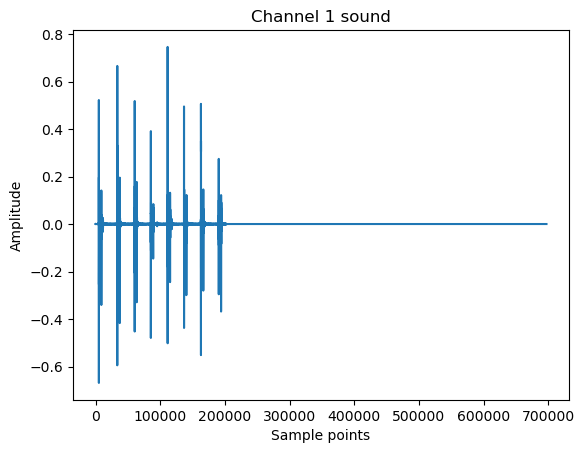

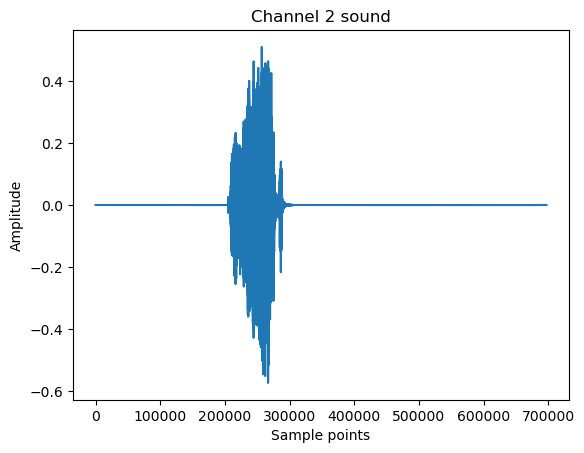

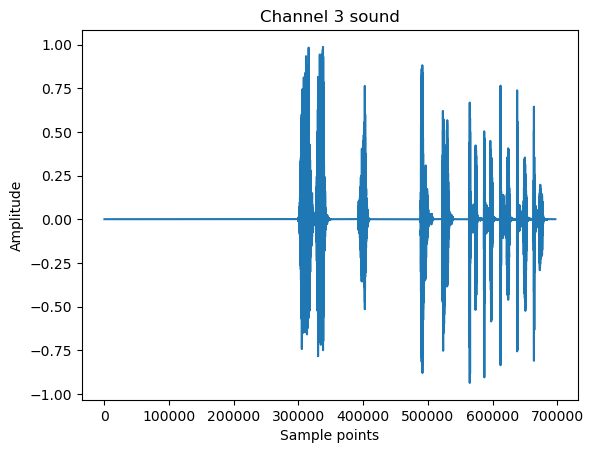

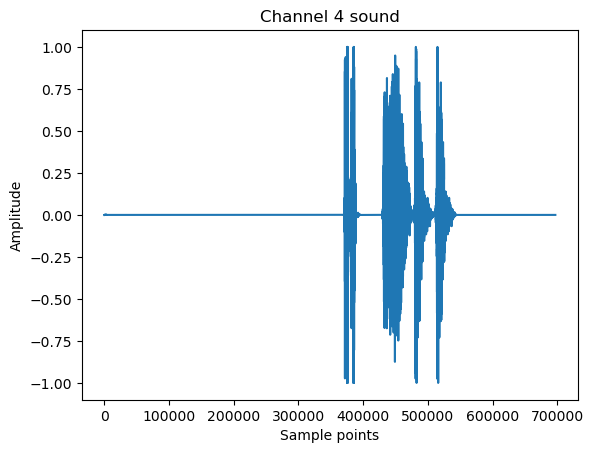

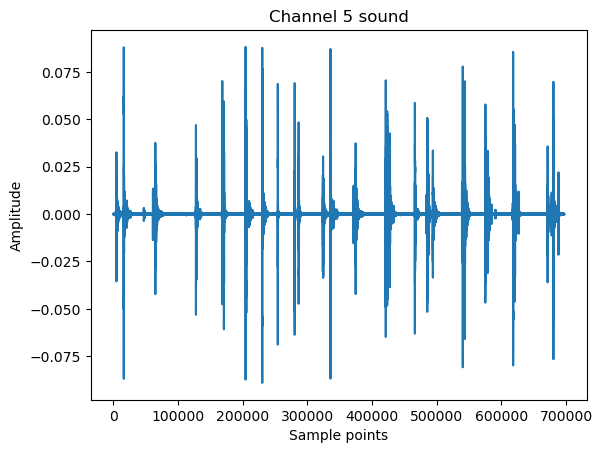

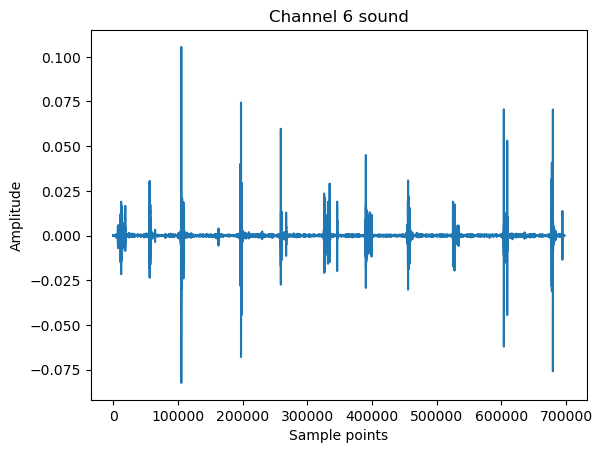

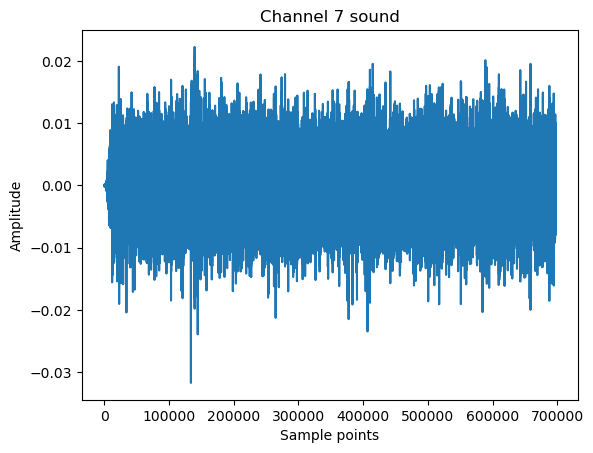

In [11]:
sounds, sample_rate = sf.read("dry.wav")
for i in range(sound.shape[1]):
    plt.figure(i)
    single_sound = sounds[:,i]

    plt.plot(single_sound)
    plt.xlabel("Sample points")
    plt.ylabel("Amplitude")
    title = "Channel {} sound".format(i+1)
    plt.title(title)
    play_sound(single_sound,sample_rate,title)

print("Channel 1: footsteps")
print("Channel 2: door opening")
print("Channel 3: tiger roam, cough")
print("Channel 4: bullets loaded, somebody being shot")
print("Channel 5: water drop")
print("Channel 6: slower water drop")
print("Channel 7: water fall")

# Extracted sound parts that I'll use

In [62]:
footsteps_sound = sounds[:,0][:200000]
door_opening_sound = sounds[:,1][200000:300000]
tiger_roam_cough_sound = sounds[:,2][290000:]
bullets_sound = sounds[:,3][350000:550000]
water_drop_sound = sounds[:,4]
slower_water_drop_sound = sounds[:,5]
water_fall_sound = sounds[:,6]


# Add reverberation and 3D effect

In [29]:
sound_speed = 340
def comb_filter(distance, gain_loss):
    time_difference = 2*distance/sound_speed
    sample_points_between_direct_and_reverbed = int(time_difference*sample_rate)+1
    filter = np.zeros(sample_points_between_direct_and_reverbed)
    filter[0] = 1
    filter[sample_points_between_direct_and_reverbed-1] = -gain_loss
    return filter

def allpass_filter(distance, gain_loss):
    time_difference = 2*distance/sound_speed
    sample_points = int(time_difference*sample_rate)+1
    b = np.zeros(sample_points)
    b[0] = gain_loss
    b[-1] = 1
    a = np.zeros(sample_points)
    a[0] = 1
    a[-1] = gain_loss
    return b,a

num_of_combs = 3
combs_distances_range = [1,20]
combs_gains_range = [0.8,0.2]
combs_distances = np.linspace(combs_distances_range[0],combs_distances_range[1],num_of_combs)
combs_gains = np.linspace(combs_gains_range[0],combs_gains_range[1],num_of_combs)
allpass_distances = [3,8]
allpass_gains = [0.7,0.4]
dryness_level = 0.5

def wet_reverb(sound,dryness_level):
    #comb filter
    sound = np.array(sound)
    after_all_combed_sound = []
    combs_distances = np.linspace(combs_distances_range[0],combs_distances_range[1],num_of_combs)
    combs_gains = np.linspace(combs_gains_range[0],combs_gains_range[1],num_of_combs)
    for i in range(num_of_combs):
        filter = comb_filter(combs_distances[i],combs_gains[i])
        combed_sound = signal.lfilter([1], filter, sound)
        if i == 0:
            after_all_combed_sound = combed_sound
        else:
            after_all_combed_sound+=combed_sound

    #allpass filter
    after_allpass_filter_sound = after_all_combed_sound
    for i in range(len(allpass_distances)):
        b,a = allpass_filter(allpass_distances[i],allpass_gains[i])
        after_allpass_filter_sound = signal.lfilter(b,a, after_allpass_filter_sound)
    #add dryness level
    final_sound = after_allpass_filter_sound+sound*dryness_level
    return final_sound



I added reverberation and 3D effect to the footprint sound so that
it sounds more vivid in a room and it movfrom backward to forward.

tiger roam and cough sound is set from the right ear and added reverb.

I set the door opening sound from the left side using hrtf

I added reverb to the bullets sound

I add reverb to the slower_water_drop_sound, and set it coming from left

In [82]:
footsteps_sound = sounds[:,0][:200000]
door_opening_sound = sounds[:,1][200000:300000]
tiger_roam_cough_sound = sounds[:,2][290000:]
bullets_sound = sounds[:,3][350000:550000]
water_drop_sound = sounds[:,4]
slower_water_drop_sound = sounds[:,5]
water_fall_sound = sounds[:,6]
dryness = 1.5
footsteps_sound = wet_reverb(footsteps_sound, dryness)
footsteps_sound = moving_sound(footsteps_sound,180,360)
#footsteps_sound = wet_reverb(footsteps_sound,sample_rate,dryness_level)

play_sound(footsteps_sound,sample_rate,"Changed footstep sound")

tiger_roam_cough_sound = wet_reverb(tiger_roam_cough_sound,dryness_level)
tiger_roam_cough_sound = hrtf(tiger_roam_cough_sound,90,0)

play_sound(tiger_roam_cough_sound,sample_rate,"changed tiger roam, cough sound")

bullets_sound = wet_reverb(bullets_sound,dryness)
bullets_sound = [bullets_sound,bullets_sound]
play_sound(bullets_sound,sample_rate,"changed bullets sound")

door_opening_sound = hrtf(door_opening_sound,270,0)
play_sound(door_opening_sound,sample_rate,"changed door opening sound")

slower_water_drop_sound = wet_reverb(slower_water_drop_sound, dryness)
slower_water_drop_sound = hrtf(slower_water_drop_sound[:240000], 270,0)
play_sound(slower_water_drop_sound,sample_rate, "changed and intercepted slow water drop sound")

water_drop_sound = wet_reverb(water_drop_sound, dryness)
water_drop_sound = hrtf(water_drop_sound[:240000], 180,0)
play_sound(water_drop_sound,sample_rate, "changed and intercepted normal water drop sound")

water_fall_sound = wet_reverb(water_fall_sound,dryness)
water_fall_sound = moving_sound(water_fall_sound[:240000],0,360)
play_sound(water_fall_sound,sample_rate, "changed and intercepted water fall sound")


Changed footstep sound


"changed tiger roam, cough sound"


changed bullets sound


changed door opening sound


changed slow water drop sound


changed normal water drop sound


changed water fall sound


# Make a story based on the changed sounds

The story is like this:

This is a sad story.
Background: Mr Tiger wanted to kill his lovely wife, Miss Cat. So he prepared a gun and waited behind the door.
When Miss Cat walked through the corridor and opened the door, they quarrelled for a while.
Then Mr Tiger shot his wife in anger. But Miss Cat still loved hime.
So her blood fist falled onto the ground drop by drop, then it dropped faster.
Finally the blood flow became stronger and stronger and formed a river.

In [83]:
story_sound = [np.array([]),np.array([])]
story_sound[0] = np.concatenate([story_sound[0],footsteps_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],footsteps_sound[1]])

story_sound[0] = np.concatenate([story_sound[0],door_opening_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],door_opening_sound[1]])


story_sound[0] = np.concatenate([story_sound[0],tiger_roam_cough_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],tiger_roam_cough_sound[1]])

story_sound[0] = np.concatenate([story_sound[0],bullets_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],bullets_sound[1]])

story_sound[0] = np.concatenate([story_sound[0],slower_water_drop_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],slower_water_drop_sound[1]])

story_sound[0] = np.concatenate([story_sound[0],water_drop_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],water_drop_sound[1]])

story_sound[0] = np.concatenate([story_sound[0],water_fall_sound[0]])
story_sound[1] = np.concatenate([story_sound[1],water_fall_sound[1]])


play_sound(story_sound,sample_rate, "Story")

Story
